In [1]:
#importing libraries
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Creating our virtual roulette wheel
"""
In American Roulette, there are 18 red pockets, 18 black pockets, 
and 2 green pockets that the ball can fall into after spinning around the wheel
"""
roulette_wheel = ['red']*18 + ['black']*18 + ['green']*2
print(roulette_wheel)

['red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'red', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'black', 'green', 'green']


### Constant Bet - Small amounts

In [3]:
# Creating a function to simulate a strategy where the player always bets the same color and the same amount of money (e.g. black, $1)

def always_play_red(bankroll, bet):
    bankroll_history = [] # List to keep track to player's bankroll over time
    
    while bankroll > 0: # A player is allowed to bet, as long as they have money in their bankroll
        
        ball = random.choice(roulette_wheel)
        if ball == 'red':
            bankroll += bet # A win on a color bet pays at 1:1 odds; for example, a player wins $1 on a $1 bet.
        else:
            bankroll -= bet # A loss results in a decrease in the bankroll in the amount bet.
        
        bankroll_history.append(bankroll)
    
    return bankroll_history

In [4]:
# We can use Monte Carlo to simulate various outcomes to see what happens to the bankroll over time starting at $100 and betting $1

def plot_simulation(num_simulations):
    plt.style.use('fivethirtyeight')
    for _ in range(num_simulations):
        plt.plot(always_play_red(bankroll=100, bet=1), linewidth=0.5)

    plt.xlabel("Number of Games Played", fontsize=12)
    plt.ylabel("Bankroll ($)", fontsize=12)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.title("Same Color Strategy - Bankroll Over Time", fontsize=16)
    plt.tight_layout()
    plt.savefig(f'images/{num_simulations}_simulations.png', dpi=300)


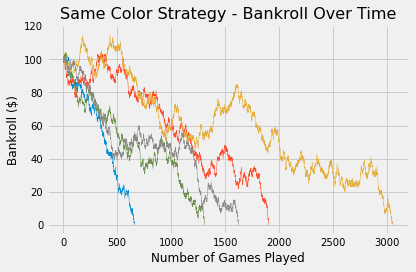

In [5]:
plot_simulation(5)

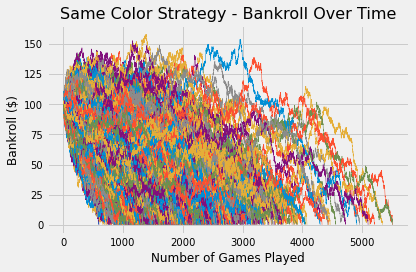

In [6]:
plot_simulation(1000)

### Constant Bet - Large amounts

In [7]:
def plot_simulation(num_simulations):
    plt.style.use('fivethirtyeight')
    for _ in range(num_simulations):
        plt.plot(always_play_red(bankroll=100, bet=100), linewidth=0.5)

    plt.xlabel("Number of Games Played", fontsize=12)
    plt.ylabel("Bankroll ($)", fontsize=12)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.title("Same Color Strategy - Bankroll Over Time", fontsize=16)
    plt.tight_layout()
    plt.savefig(f'images/{num_simulations}_simulations.png', dpi=300)

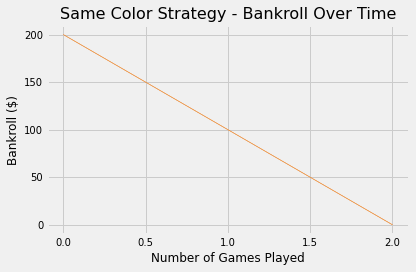

In [8]:
plot_simulation(5)

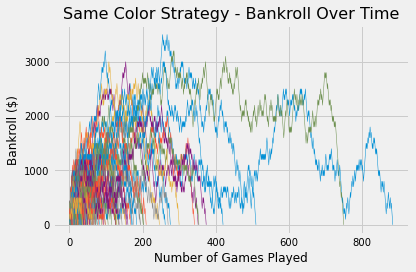

In [9]:
plot_simulation(1000)

### Martingale Strategy

In [10]:
# Creating a function to simulate a strategy where the player doubles the bet for every win

def martingale(bankroll, bet):
    bankroll_history = [] # List to keep track to player's bankroll over time
    
    while bankroll > 0: # A player is allowed to bed, as long as they have money in their bankroll
        if bet > bankroll:
            bet = bankroll
        ball = random.choice(roulette_wheel)
        if ball == 'red':
            bankroll += bet # A win on a color bet pays at 1:1 odds; for example, a player wins $1 on a $1 bet
            bet = 0.01
        else:
            bankroll -= bet # A loss results in a decrease in the bankroll in the amount bet
            bet *= 2
        
        bankroll_history.append(bankroll)
    
    return bankroll_history

In [11]:
def plot_simulation(num_simulations):
    plt.style.use('fivethirtyeight')
    for _ in range(num_simulations):
        plt.plot(martingale(bankroll=100, bet=0.01), linewidth=0.5)

    plt.xlabel("Number of Games Played", fontsize=12)
    plt.ylabel("Bankroll ($)", fontsize=12)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.title("Martingale Strategy - Bankroll Over Time", fontsize=16)
    plt.tight_layout()
    plt.savefig(f'images/{num_simulations}_simulations_double_down.png', dpi=300)

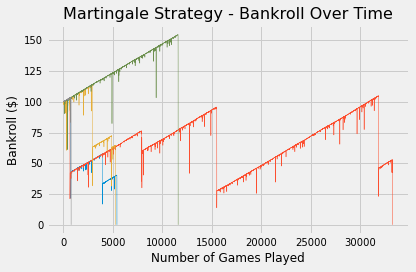

In [12]:
plot_simulation(5)

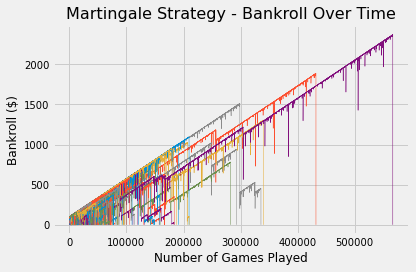

In [13]:
plot_simulation(1000)